In [36]:
import numpy as np 
import pandas as pd 
#import pandas_profiling as pp
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import os

# 1.Reading the data

In [37]:
higg_test=pd.read_csv("C:\\Users\\Debashish\\Downloads\\Higgs_Test.csv")

# 2. Understanding,Summary Statistics Data

In [38]:
#pp.ProfileReport(higg_test)

#### Dropping the "id" column as it will put impact on the result.

In [4]:
#higg_test.drop(columns=['id'], axis = 1, inplace = True)

In [5]:
higg_test.dtypes

class                         int64
lepton_pT                   float64
lepton_eta                  float64
lepton_phi                  float64
missing_energy_magnitude    float64
missing_energy_phi          float64
jet1pt                      float64
jet1eta                     float64
jet1phi                     float64
jet1b.tag                   float64
jet2pt                      float64
jet2eta                     float64
jet2phi                     float64
jet2b.tag                   float64
jet3pt                      float64
jet3eta                     float64
jet3phi                     float64
jet3b.tag                   float64
jet4pt                      float64
jet4eta                     float64
jet4phi                      object
jet4b.tag                    object
m_jj                         object
m_jjj                        object
m_lv                         object
m_jlv                        object
m_bb                         object
m_wbb                       

# 3. Data pre-processing

#### The following columns are having 5 levels. So, converting the columns into "Categorical" type

In [6]:
for col in ["jet1b.tag","jet2b.tag","jet3b.tag","jet4b.tag","class"]:
        higg_test[col] = higg_test[col].astype('category')
cat_attr = list(higg_test.select_dtypes(include=['category']).columns)
cat_attr.pop(0)

'class'

In [7]:
cat_attr

['jet1b.tag', 'jet2b.tag', 'jet3b.tag', 'jet4b.tag']

#### The following object contains all the numerical variables

In [8]:
num_attr = list(higg_test.columns.difference(cat_attr))
num_attr.pop(0)

'class'

In [9]:
num_attr = list(higg_test.select_dtypes(include=['float']).columns)

In [10]:
num_attr

['lepton_pT',
 'lepton_eta',
 'lepton_phi',
 'missing_energy_magnitude',
 'missing_energy_phi',
 'jet1pt',
 'jet1eta',
 'jet1phi',
 'jet2pt',
 'jet2eta',
 'jet2phi',
 'jet3pt',
 'jet3eta',
 'jet3phi',
 'jet4pt',
 'jet4eta']

#  Test split of Dependent and Independent variables.

#### Separating the independent and dependent variables

In [11]:
X, y = higg_test.loc[:,higg_test.columns!='class'], higg_test.loc[:,'class']

In [12]:
print(X.columns)

Index(['lepton_pT', 'lepton_eta', 'lepton_phi', 'missing_energy_magnitude',
       'missing_energy_phi', 'jet1pt', 'jet1eta', 'jet1phi', 'jet1b.tag',
       'jet2pt', 'jet2eta', 'jet2phi', 'jet2b.tag', 'jet3pt', 'jet3eta',
       'jet3phi', 'jet3b.tag', 'jet4pt', 'jet4eta', 'jet4phi', 'jet4b.tag',
       'm_jj', 'm_jjj', 'm_lv', 'm_jlv', 'm_bb', 'm_wbb', 'm_wwbb', 'id'],
      dtype='object')


In [13]:
X=X.drop(['id'], axis = 1) 

#### Train/Test split

In [14]:
## Print the shape of X_train, X_test, y_train, y_test
print(X.shape)
print(y.shape)

(29414, 28)
(29414,)


#### a)Splitting the categorical and numerical data and imputing the missing values
#### b)Saving the data in the respective objects and making them into a dataframe.

In [15]:
from sklearn.impute import SimpleImputer

cat_imputer = SimpleImputer(strategy='most_frequent')
cat_imputer = cat_imputer.fit(X[cat_attr])

X_cat = cat_imputer.transform(X[cat_attr])
X_cat = pd.DataFrame(X_cat, columns= cat_attr)


In [16]:
from sklearn.impute import SimpleImputer

num_imputer = SimpleImputer(strategy='mean')
num_imputer = num_imputer.fit(X[num_attr])

X_num = num_imputer.transform(X[num_attr])
X_num = pd.DataFrame(X_num, columns=num_attr)

#### Encoding Categorical Attributes to Numeric - OneHotEncoding

In [17]:
from sklearn.preprocessing import OneHotEncoder
onehotencoder = OneHotEncoder(handle_unknown='ignore')
onehotencoder = onehotencoder.fit(X_cat)
ohe_cat_col_names = onehotencoder.get_feature_names(cat_attr)
ohe_cat_col_names

array(['jet1b.tag_0.0', 'jet1b.tag_1.086538',
       'jet1b.tag_1.0865380759999999', 'jet1b.tag_2.173076',
       'jet1b.tag_2.1730761530000002', 'jet2b.tag_0.0',
       'jet2b.tag_1.107436', 'jet2b.tag_1.107436061',
       'jet2b.tag_2.214872', 'jet2b.tag_2.214872122', 'jet3b.tag_0.0',
       'jet3b.tag_1.2741120000000001', 'jet3b.tag_1.274112225',
       'jet3b.tag_2.5482240000000003', 'jet3b.tag_2.548224449',
       'jet4b.tag_0', 'jet4b.tag_1.550980687', 'jet4b.tag_3.101961374',
       'jet4b.tag_?'], dtype=object)

In [18]:
X_cat_onehotencoded = onehotencoder.transform(X_cat).toarray()
X_cat_onehotencoded = pd.DataFrame(X_cat_onehotencoded, columns=ohe_cat_col_names)
X_cat_onehotencoded.head()

,jet1b.tag_0.0,jet1b.tag_1.086538,jet1b.tag_1.0865380759999999,jet1b.tag_2.173076,jet1b.tag_2.1730761530000002,jet2b.tag_0.0,jet2b.tag_1.107436,jet2b.tag_1.107436061,jet2b.tag_2.214872,jet2b.tag_2.214872122,jet3b.tag_0.0,jet3b.tag_1.2741120000000001,jet3b.tag_1.274112225,jet3b.tag_2.5482240000000003,jet3b.tag_2.548224449,jet4b.tag_0,jet4b.tag_1.550980687,jet4b.tag_3.101961374,jet4b.tag_?
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [19]:
X_num.shape

(29414, 16)

#### Merging the categorical and numerical columns into test data

In [20]:
X= pd.concat([X_num.reset_index(), X_cat_onehotencoded], axis=1)

In [21]:
print(X.shape)
print(len(y))

(29414, 36)
29414


In [22]:
y=y.astype('category')

In [23]:
y.unique()

[1, 0]
Categories (2, int64): [1, 0]

#### Applying the Random Forest-Decision Tree Algorithm to aolve this classification problem

In [24]:
from sklearn.ensemble import RandomForestClassifier
clf_rf = RandomForestClassifier()

#### Finding the best parameters to build a model through GridSearchCV

In [25]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV

kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=143)

param_grid = {"n_estimators" : [30,36],
              "max_depth" : [5,8],
              "max_features" : [8,10],
              "min_samples_leaf" : [4, 6]}

rf_grid = GridSearchCV(clf_rf, param_grid= param_grid, cv=kfold)

#### Fitting the model into Train data

In [26]:
rf_grid.fit(X,y)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=143, shuffle=True),
             error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                           

In [27]:
rf_grid.best_params_

{'max_depth': 8, 'max_features': 10, 'min_samples_leaf': 4, 'n_estimators': 36}

In [28]:
rf_grid.best_estimator_.feature_importances_

array([0.02025723, 0.15386967, 0.03007522, 0.02026004, 0.16185928,
       0.0219287 , 0.13488125, 0.03706657, 0.01959785, 0.0748136 ,
       0.03170221, 0.02290489, 0.04915122, 0.02480532, 0.02147205,
       0.040986  , 0.03202344, 0.0346085 , 0.0013656 , 0.00071188,
       0.00861576, 0.00309626, 0.02650728, 0.00085019, 0.00039696,
       0.00186118, 0.00138999, 0.00931927, 0.00060799, 0.00029497,
       0.00298647, 0.00148057, 0.00434223, 0.00017642, 0.00373393,
       0.        ])

#### Sorting the features according to their score

In [29]:
features = X.columns
importances = rf_grid.best_estimator_.feature_importances_
indices = np.argsort(importances)[::-1] # np.argsort returns the indices that would sort an array.
pd.DataFrame([X.columns[indices],np.sort(importances)[::-1]])

,0,1,2,3,4,5,6,7,8,9,...,26,27,28,29,30,31,32,33,34,35
0,missing_energy_magnitude,lepton_pT,jet1pt,jet2pt,jet3pt,jet4pt,jet1eta,jet1b.tag_0.0,jet4eta,jet2eta,...,jet3b.tag_2.548224449,jet2b.tag_2.214872122,jet1b.tag_1.086538,jet2b.tag_1.107436,jet1b.tag_1.0865380759999999,jet3b.tag_1.2741120000000001,jet2b.tag_1.107436061,jet3b.tag_1.274112225,jet4b.tag_1.550980687,jet4b.tag_?
1,0.161859,0.15387,0.134881,0.0748136,0.0491512,0.040986,0.0370666,0.0346085,0.0320234,0.0317022,...,0.00148057,0.00138999,0.0013656,0.000850185,0.000711877,0.000607988,0.000396959,0.000294969,0.00017642,0


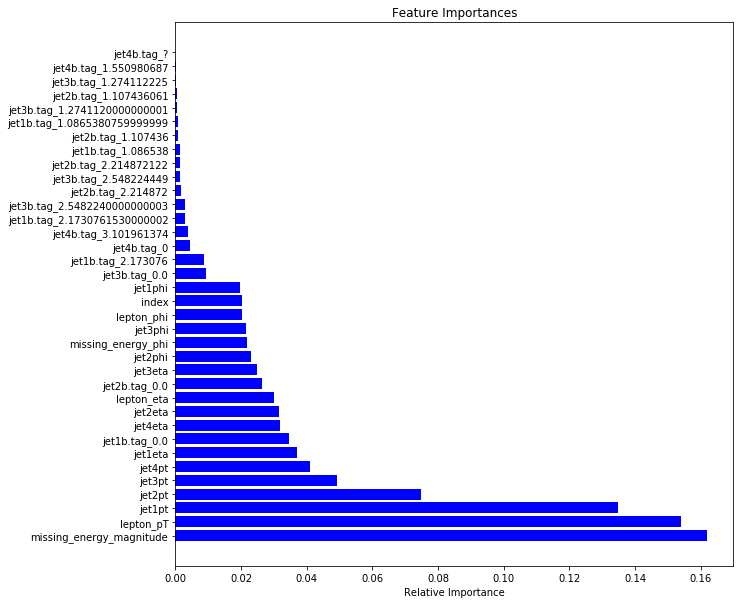

In [30]:
plt.figure(figsize = (10, 10))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='blue')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

#### Predicting the test data

In [31]:
test_pred = rf_grid.predict(X)

#### Define custom function to print accuracy, precision and recall

In [32]:
# Define custom function to print accuracy, precision and recall
from sklearn.metrics import accuracy_score

def convert_for_sklearn(label_list):
    return [1 if i == 'Yes' else 0 for i in label_list]


def accuracy(y_true, y_pred, data_mode):
    
    y_test_scoring = convert_for_sklearn(y_true)
    test_pred_scoring = convert_for_sklearn(y_pred)
    
#     y_test_scoring = y_true
#     test_pred_scoring = y_pred
    
    acc = accuracy_score(y_true= y_test_scoring, y_pred = test_pred_scoring)
    
    print(f"{data_mode} Accuracy: ",acc)

#### Accuracy Score for Test Data

In [33]:
accuracy(y_true = y, y_pred = test_pred, data_mode='Test')

Test Accuracy:  1.0


#### Saving the result into CSV files

In [34]:
prediction=pd.DataFrame(test_pred,columns=["class"])
id=pd.DataFrame(higg_test["id"],columns=["id"])
result=pd.concat([id,prediction],axis=1).to_csv('3655_Debashish Patnaik_Batch 80_OutputPrediction.csv',index=None)